# Assignment 1

## Ian Scarff (iie728)

In [1]:
import torch
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import plotly
import plotly.graph_objects as go

## Task 1

Find all local max and min values for the following function:

$ y = 3x - 6x^3 - x^4 + 4 $ where $ -6 \leq x \leq 1 $ 

In [2]:
### First, create an array with values in range of x
x_range = np.linspace(start = -6, stop = 1, num = 100000)
x_range

array([-6.     , -5.99993, -5.99986, ...,  0.99986,  0.99993,  1.     ])

In [3]:
### Solve the equation for y values
y_range = 3*x_range - 6*x_range**3 - x_range**4 + 4
y_range

array([-1.40000000e+01, -1.39846704e+01, -1.39693418e+01, ...,
        2.65955622e-03,  1.32989570e-03,  0.00000000e+00])

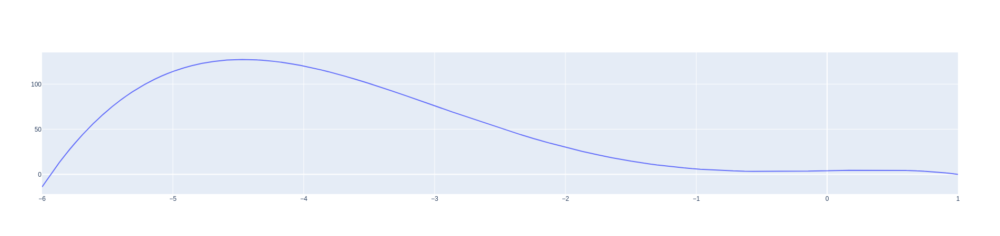

In [4]:
## Visualize function
fig = go.Figure(data = go.Scatter(x = x_range, y = y_range))
fig.show()

In [5]:
### Calculate derivatives
dydx = np.empty((0), float)
for i in x_range:
    x = torch.tensor(i, requires_grad = True)
    y = 3*x - 6*x**3 - x**4 + 4
    y.backward()
    dydx = np.append(dydx, x.grad.item())
    
dydx

array([219.        , 218.98488011, 218.96976076, ..., -18.99328052,
       -18.99664011, -19.        ])

In [6]:
### It is impossible to find the true min and max values given that we are not operating and an infinite number of obsv.
### To find all local max and min, find where derivative (slope) is close to 0
np.where(abs(dydx) < 0.01)

(array([21965, 21966, 21967, 21968, 79571, 79572, 79573, 79574, 79575,
        79576, 79577, 79578, 79579, 79580, 79581, 79582, 79583, 79584,
        79585, 79586, 79587, 79588, 79589, 79590, 79591, 79592, 91299,
        91300, 91301, 91302, 91303, 91304, 91305, 91306, 91307, 91308,
        91309, 91310, 91311, 91312, 91313, 91314, 91315, 91316]),)

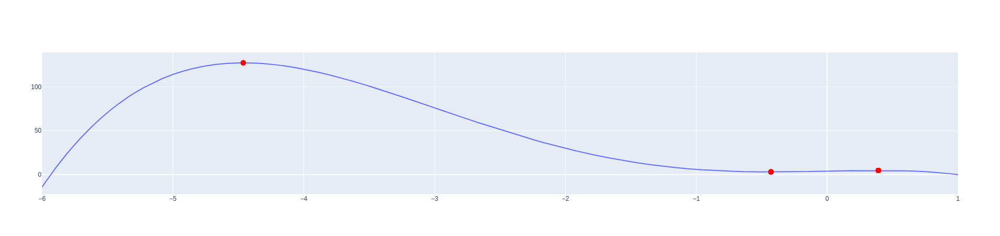

In [7]:
### Plot these values
fig = go.Figure()
fig.add_trace(go.Scatter(x = x_range, y = y_range, showlegend = False))
for i in np.where(abs(dydx) < 0.01):
    fig.add_trace(go.Scatter(x = x_range[i], y = y_range[i], mode = 'markers', showlegend = False, 
                             marker = dict(color = 'red', size = 10)))


fig.show()

# 
# 

## Task 2

Find all local max and min values for the following function:

$ z = cos(x)sin(y) $ where $ -\pi \leq x,y \leq \pi $ 

In [8]:
### First, create an array with values in range of x and y
x_range = np.linspace(start = -1 * math.pi, stop = math.pi, num = 500)
y_range = np.linspace(start = -1 * math.pi, stop = math.pi, num = 500)

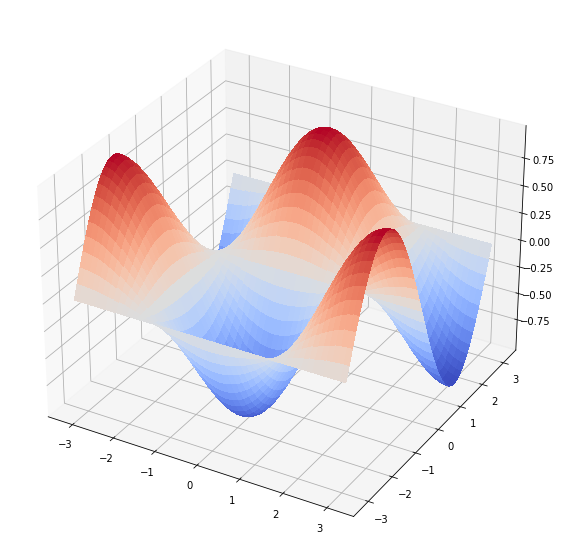

In [18]:
### Vizualize function
fig, ax = plt.subplots(subplot_kw={"projection": "3d"}, figsize = (20,10))
X, Y = np.meshgrid(x_range, y_range)
Z = np.cos(X) * np.sin(Y)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)

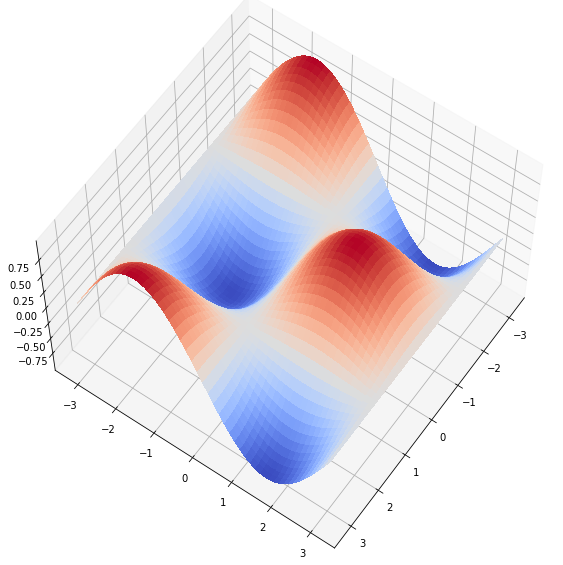

In [17]:
### Vizualize function
fig, ax = plt.subplots(subplot_kw={"projection": "3d"}, figsize = (20,10))
X, Y = np.meshgrid(x_range, y_range)
Z = np.cos(X) * np.sin(Y)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
ax.view_init(60, 35)


In [10]:
### Calculate derivatives
dzdx = np.empty((0), float)
dzdy = np.empty((0), float)
points = []

for i in x_range:
    for j in y_range:
        
        points.append([i,j]) ### Keep track of current point
        
        x = torch.tensor(i, requires_grad = True)
        y = torch.tensor(j, requires_grad = True)
        z = torch.cos(x) * torch.sin(y)
        z.backward()
        dzdx = np.append(dzdx, x.grad.item())
        dzdy = np.append(dzdy, y.grad.item())


In [11]:
### Find which set of points have derivative of x and y near 0
np.where((abs(dzdx) < 0.01))

(array([     0,      1,      2, ..., 249997, 249998, 249999]),)

In [12]:
np.where((abs(dzdy) < 0.01))

(array([   124,    125,    374, ..., 249625, 249874, 249875]),)

In [13]:
### Are there points where the derivatives of both x and y are close to 0?
np.any(np.in1d(np.where((abs(dzdy) < 0.01)), np.where((abs(dzdx) < 0.01))))

True

In [16]:
derv_0_points = [] ### Points where both derivatives of x and y are near 0
for i in np.where((abs(dzdx) < 0.01))[0]:
    for j in np.where((abs(dzdy) < 0.01))[0]:
        if (i == j):
            derv_0_points.append(i)
derv_0_points

[124,
 125,
 374,
 375,
 62000,
 62249,
 62250,
 62499,
 62500,
 62749,
 62750,
 62999,
 124624,
 124625,
 124874,
 124875,
 125124,
 125125,
 125374,
 125375,
 187000,
 187249,
 187250,
 187499,
 187500,
 187749,
 187750,
 187999,
 249624,
 249625,
 249874,
 249875]

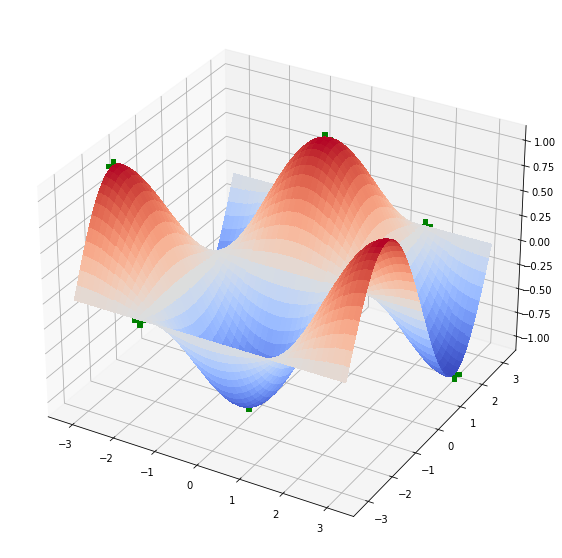

In [43]:
### Vizualize function
fig, ax = plt.subplots(subplot_kw={"projection": "3d"}, figsize = (20,10))
X, Y = np.meshgrid(x_range, y_range)
Z = np.cos(X) * np.sin(Y)

# Plot the surface.
ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
# ax.view_init(60, 35)
for i in derv_0_points:
    z_coord = math.cos(points[i][0]) * math.sin(points[i][1])
    ax.scatter(points[i][0], points[i][1], z_coord, marker = 'P', c = 'green', s = 200)

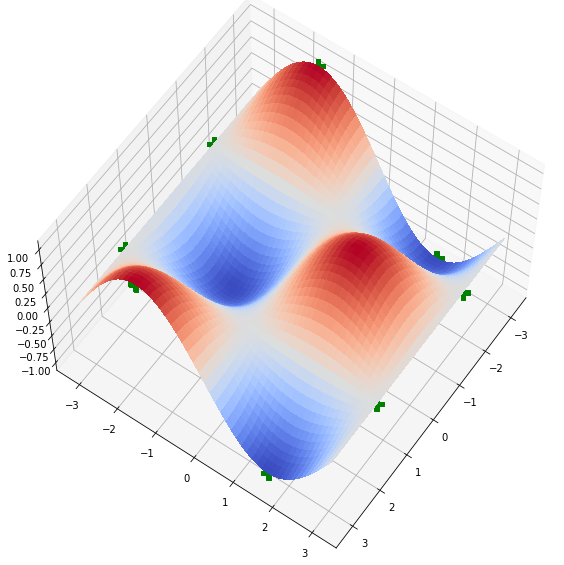

In [42]:
### Vizualize function
fig, ax = plt.subplots(subplot_kw={"projection": "3d"}, figsize = (20,10))
X, Y = np.meshgrid(x_range, y_range)
Z = np.cos(X) * np.sin(Y)

# Plot the surface.
ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
ax.view_init(60, 35)
for i in derv_0_points:
    z_coord = math.cos(points[i][0]) * math.sin(points[i][1])
    ax.scatter(points[i][0], points[i][1], z_coord, marker = 'P', c = 'green', s = 200)